## Use join_frogs to create new training df, while doing EDA on it

In [31]:
# Supress Warnings 
import warnings
warnings.filterwarnings('ignore')
# Plotting
import matplotlib.pyplot as plt
import seaborn as sns
# Data science
import pandas as pd
import numpy as np
# Geospatial
import contextily as cx
import xarray as xr
import zarr # Not referenced, but required for xarray
# Import Planetary Computer tools
import fsspec
import pystac
# Other
import os
import zipfile
from itertools import cycle

import folium
from itertools import cycle
import contextily as cx
data_path = '../'

output_path = './output/'

In [3]:
# Define the function we're gonna use
def join_frogs(frogs, data):
    """Collects the data for each frog location and joins it onto the frog data 
    Arguments:
    frogs -- dataframe containing the response variable along with ["decimalLongitude", "decimalLatitude", "key"]
    data -- xarray dataarray of features, indexed with geocoordinates
    """
    return frogs.merge(
        (data.rename('data').sel(
                x=xr.DataArray(frogs.decimalLongitude, dims="key", coords={"key": frogs.key}), 
                y=xr.DataArray(frogs.decimalLatitude, dims="key", coords={"key": frogs.key}),
                method="nearest"
            )
            .to_dataframe()
            .assign(val = lambda x: x.iloc[:, -1])
            [['val']]
            .reset_index()
            .drop_duplicates()
            .pivot(index="key", columns="band", values="val")
            .reset_index()
        ),
        on = ['key'],
        how = 'inner'
    )

In [4]:
# Read in stuff we're gonna join
# read in the stuff we need to join. Read in as dataarray, not as dataset, so that we can use .rename('data')
weather_data1 = xr.open_dataarray('weather_data_1012.nc')
weather_data2 = xr.open_dataarray('weather_data_1314.nc')
weather_data3 = xr.open_dataarray('weather_data_1516.nc')
weather_data4 = xr.open_dataarray('weather_data_17.nc')
weather_data5 = xr.open_dataarray('weather_data_18.nc')
weather_data6 = xr.open_dataarray('weather_data_1920.nc')
frogs = pd.read_csv('pseudo_absence.csv')

In [8]:
weather_data2

<xarray.DataArray (band: 11, y: 512, x: 512)>
[2883584 values with dtype=float64]
Coordinates:
  * x        (x) float64 112.0 112.1 112.2 112.2 ... 153.8 153.8 153.9 154.0
  * y        (y) float64 -43.65 -43.58 -43.52 -43.45 ... -10.03 -9.966 -9.9
  * band     (band) object 'tmax_mean' 'tmin_mean' ... 'q_mean' 'vpd_mean'

In [17]:
frogs['species'] = 'pseudo'

In [24]:
frogs = frogs.rename(columns = {'latitude':'decimalLatitude','longitude':'decimalLongitude'})

In [30]:
frogs.describe()

,Unnamed: 0,decimalLatitude,decimalLongitude
count,30000.000000,30000.000000,30000.000000
mean,14999.500000,-19.940197,124.959803
std,8660.398374,5.771007,5.771007
min,0.000000,-29.999670,114.900330
25%,7499.750000,-24.929490,119.970510
50%,14999.500000,-19.875400,125.024600
75%,22499.250000,-14.984067,129.915933
max,29999.000000,-9.900360,134.999640


<AxesSubplot:xlabel='decimalLatitude', ylabel='Count'>

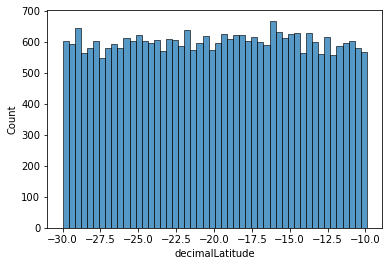

In [39]:
sns.histplot(data = frogs, x ='decimalLatitude', bins = 50)

<AxesSubplot:xlabel='decimalLongitude', ylabel='Count'>

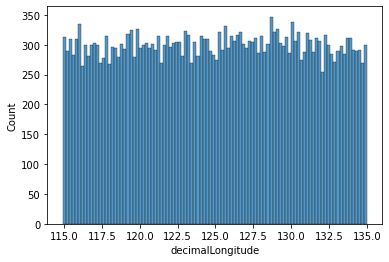

In [41]:
sns.histplot(data = frogs, x = 'decimalLongitude', bins = 100)

In [18]:
species_colourmap = {species:colour['color'] for species, colour in zip(frogs.species.value_counts().index, cycle(plt.rcParams['axes.prop_cycle']))}


In [29]:
# Try to visualize our frog data
# Plotting functions
def plotDot(point, folium_map, species_colours):
    folium.CircleMarker(
        location=[point.decimalLatitude, point.decimalLongitude],
        radius=10,
        stroke=False,
        weight=5,
        fill=True,
        fillOpacity=1.0,
        opacity=1.0,
        color=species_colours[point.species]
    ).add_to(folium_map)
    
#create a map
frog_map = folium.Map(prefer_canvas=True)

# plot 1000 points from each country
frogs.apply(plotDot, axis = 1, args=(frog_map, species_colourmap))

#Set the zoom to the maximum possible
frog_map.fit_bounds(frog_map.get_bounds())
#Lat lon on click
frog_map.add_child(folium.LatLngPopup())
#Save the map to an HTML file
frog_map.save('frog_map_training.html')
frog_map

In [9]:
pd.read_csv('30kfrogs.csv')

,Unnamed: 0.1,Unnamed: 0,gbifID,eventDate,country,continent,stateProvince,decimalLatitude,decimalLongitude,species,coordinateUncertaintyInMeters,occurrenceStatus,key
0,0,25984,3463687745,2020-03-21 00:00:00,Australia,Australia,New South Wales,-35.493347,150.369076,Crinia Signifera,30.0,0,0
1,1,183108,3108896846,2019-11-01 00:00:00,Australia,Australia,New South Wales,-35.946277,148.626597,Crinia Signifera,5.0,0,1
2,2,45457,3463551873,2020-10-07 00:00:00,Australia,Australia,New South Wales,-35.377700,149.206000,Crinia Signifera,9.8,0,2
3,3,172113,1071431690,2014-10-11 00:00:00,Australia,Australia,New South Wales,-32.986010,150.893219,Crinia Signifera,3.0,0,3
4,4,134046,3108871450,2018-07-09 00:00:00,Australia,Australia,New South Wales,-33.763524,151.237485,Crinia Signifera,5.0,0,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...
63327,63327,193485,2806356042,2010-12-17 00:00:00,Australia,Australia,New South Wales,-33.835933,151.062409,Litoria Fallax,100.0,1,63327
63328,63328,193486,3108865868,2019-02-03 00:00:00,Australia,Australia,New South Wales,-34.028797,151.225626,Litoria Fallax,6.0,1,63328
63329,63329,193507,3408189344,2019-12-24 21:22:00,Australia,Australia,Queensland,-26.754987,152.839291,Litoria Fallax,31.0,1,63329
63330,63330,193509,2557751115,2020-01-08 23:38:00,Australia,Australia,New South Wales,-31.941704,152.400911,Litoria Fallax,8.0,1,63330
